# New architectures for object detection based on DEtection TRansformers, Visual Transformers and class embeddings
## Evaluation, inference and attention visualization

In [158]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

1.5.0 True


In [159]:
from util.plot_utils import *
from pathlib import Path, PurePath
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'
import torchvision.transforms as T
import requests
from PIL import Image
torch.set_grad_enabled(False);

In [160]:
import argparse
from models import build_model

In [161]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
import os
from IPython.display import clear_output
import math

## Evaluation

-   solid lines are training results,
-   dashed lines are validation results.

In [162]:
log_directory = [Path('output\Pascal_VOC\dgx-lr_drop'), Path('output\Pascal_VOC\mobilenet'), Path('output\Pascal_VOC\class_emb2'), Path('output\Pascal_VOC\Vit\Vit384'),]

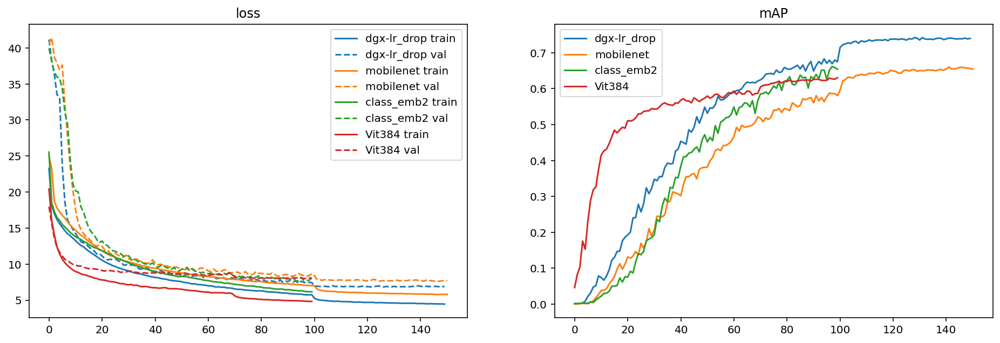

In [6]:
fields_of_interest = ('loss', 'mAP')
plot_logs(log_directory, fields_of_interest)

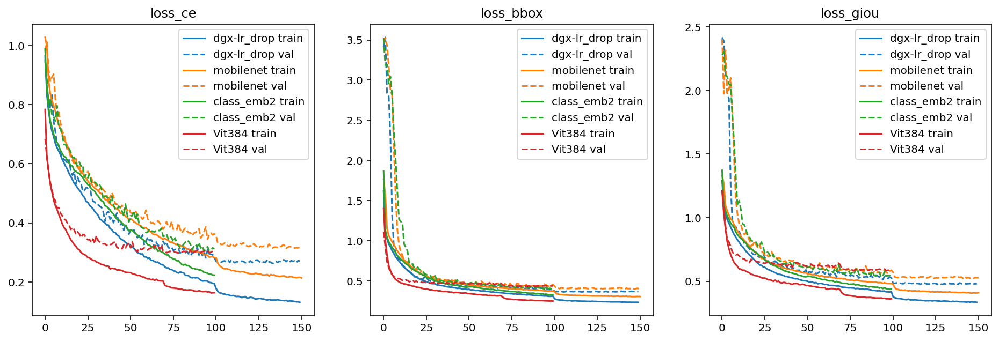

In [7]:
fields_of_interest = ('loss_ce', 'loss_bbox', 'loss_giou')
plot_logs(log_directory, fields_of_interest)

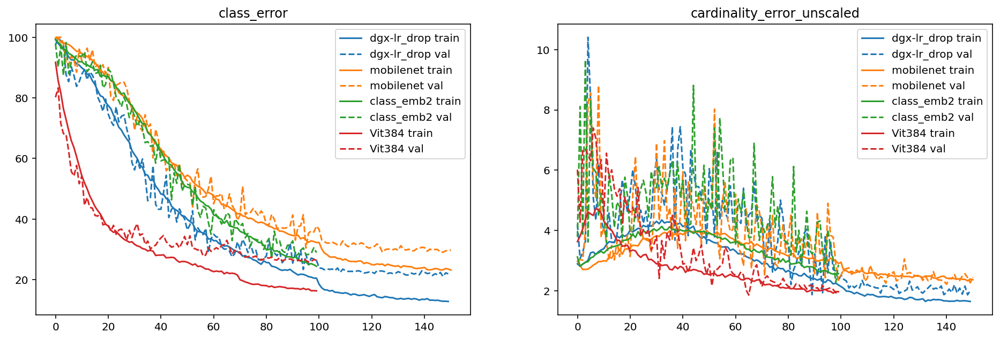

In [8]:
fields_of_interest = ('class_error', 'cardinality_error_unscaled')
plot_logs(log_directory, fields_of_interest) 

## Inference

Define args to instantiate model:

In [163]:
def get_args_parser():
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--lr', default=1e-4, type=float)
    parser.add_argument('--lr_backbone', default=1e-5, type=float)
    parser.add_argument('--batch_size', default=2, type=int)
    parser.add_argument('--weight_decay', default=1e-4, type=float)
    parser.add_argument('--epochs', default=300, type=int)
    parser.add_argument('--lr_drop', default=200, type=int)
    parser.add_argument('--clip_max_norm', default=0.1, type=float,
                        help='gradient clipping max norm')

    # Model parameters
    parser.add_argument('--num_classes', type=int, default=21,
                        help="Number of classes in dataset+1")
    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")

    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer")
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=100, type=int,
                        help="Number of query slots")
    # Loss
    parser.add_argument('--no_aux_loss', dest='aux_loss', action='store_false',
                        help="Disables auxiliary decoding losses (loss at each layer)")
    # * Matcher
    parser.add_argument('--set_cost_class', default=1, type=float,
                        help="Class coefficient in the matching cost")
    parser.add_argument('--set_cost_bbox', default=5, type=float,
                        help="L1 box coefficient in the matching cost")
    parser.add_argument('--set_cost_giou', default=2, type=float,
                        help="giou box coefficient in the matching cost")
    # * Loss coefficients
    parser.add_argument('--bbox_loss_coef', default=5, type=float)
    parser.add_argument('--giou_loss_coef', default=2, type=float)
    parser.add_argument('--eos_coef', default=0.1, type=float,
                        help="Relative classification weight of the no-object class")

    # dataset parameters
    parser.add_argument('--dataset_file', default='coco')
    parser.add_argument('--coco_path', type=str)

    parser.add_argument('--output_dir', default='',
                        help='path where to save, empty for no saving')
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    parser.add_argument('--seed', default=42, type=int)
    parser.add_argument('--resume', default='', help='resume from checkpoint')
    parser.add_argument('--start_epoch', default=0, type=int, metavar='N',
                        help='start epoch')
    parser.add_argument('--eval', action='store_true')
    parser.add_argument('--num_workers', default=2, type=int)
    
    ###
    parser.add_argument('--fine_tune', action='store_true')
    parser.add_argument('--transfer_learning', action='store_true')
    parser.add_argument('--pretrained_encoder', action='store_true')
    parser.add_argument('--vit224', action='store_true')
    parser.add_argument('--vit384', action='store_true')
    parser.add_argument('--vit640', action='store_true')
    parser.add_argument('--class_emb', action='store_true')
    ###

    return parser

In [164]:
parser = argparse.ArgumentParser('DETR evaluation and inference script', parents=[get_args_parser()])
args = parser.parse_args("")
model_type = ''

In [165]:
def init_args(model='detr'):
    global model_type
    
    if model == 'detr':
        args.resume = 'output\Pascal_VOC\dgx-lr_drop\checkpoint.pth'
        args.hidden_dim = 256
        args.backbone = 'resnet50'
        args.num_classes = 21
        args.vit384 = False
        args.class_emb = False
        args.device = 'cuda'
        
    elif model == 'vit':
        args.resume = 'output\Pascal_VOC\Vit\Vit384\checkpoint.pth'
        args.hidden_dim = 768
        args.backbone = 'resnet50'
        args.num_classes = 20
        args.vit384 = True
        args.class_emb = False
        args.device = 'cpu'
        
    elif model == 'mobilenet':
        args.resume = 'output\Pascal_VOC\mobilenet\checkpoint.pth'
        args.hidden_dim = 256
        args.backbone = 'mobilenet_v2'
        args.num_classes = 21
        args.vit384 = False
        args.class_emb = False
        args.device = 'cuda'
        
    elif model == 'class_emb':
        args.resume = 'output\Pascal_VOC\class_emb2\checkpoint.pth'
        args.hidden_dim = 256
        args.backbone = 'resnet50'
        args.num_classes = 21
        args.vit384 = False
        args.class_emb = True
        args.device = 'cuda'
        
    elif model == 'coco':
        args.resume = ''
        args.hidden_dim = 256
        args.backbone = 'resnet50'
        args.num_classes = 91
        args.vit384 = False
        args.class_emb = False
        args.device = 'cuda'
        
    args.aux_loss = False
    args.eval = True
    
    model_type = model

## Choose model

In [87]:
model_picker = widgets.Dropdown(options=[('PascalVOC DETR', 'detr'), ('MobileNet DETR', 'mobilenet'), ('DETR with class emb', 'class_emb'),
                                     ('ViT DETR', 'vit'), ('COCO DETR', 'coco')])

display(model_picker)

Dropdown(options=(('PascalVOC DETR', 'detr'), ('MobileNet DETR', 'mobilenet'), ('DETR with class emb', 'class_…

In [206]:
print(model_picker.value)
init_args(model_picker.value)

class_emb


In [207]:
print(args)

Namespace(aux_loss=False, backbone='resnet50', batch_size=2, bbox_loss_coef=5, class_emb=True, clip_max_norm=0.1, coco_path=None, dataset_file='coco', dec_layers=6, device='cuda', dilation=False, dim_feedforward=2048, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=300, eval=True, fine_tune=False, giou_loss_coef=2, hidden_dim=256, lr=0.0001, lr_backbone=1e-05, lr_drop=200, nheads=8, num_classes=21, num_queries=100, num_workers=2, output_dir='', position_embedding='sine', pretrained_encoder=False, resume='output\\Pascal_VOC\\class_emb2\\checkpoint.pth', seed=42, set_cost_bbox=5, set_cost_class=1, set_cost_giou=2, start_epoch=0, transfer_learning=False, vit224=False, vit384=False, vit640=False, weight_decay=0.0001)


### Build model & load weights

In [208]:
model, _, _ = build_model(args)

if model_type == 'coco':
    checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)
else:
    checkpoint = torch.load(args.resume, map_location='cpu')
model.load_state_dict(checkpoint['model'])
model.eval();

Building a DETR model with 22 classes
DETR: BACKBONE
BACKBONE: RESNET
TRANSFORMER: DETR
TRANSFORMER: CLASS EMB


### Utils to display inference results

Define classes and colors to display boxes:

In [209]:
if model_type == 'coco':
    CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]
else:
    CLASSES = [
        'noobject',
        'person',
        'bird',
        'cat',
        'cow',
        'dog',
        'horse',
        'sheep',
        'aeroplane',
        'bicycle',
        'boat',
        'bus',
        'car',
        'motorbike',
        'train',
        'bottle',
        'chair',
        'diningtable',
        'pottedplant',
        'sofa',
        'tvmonitor'
    ]

COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

DETR uses standard ImageNet normalization, and output boxes in relative image coordinates in $[x_{\text{center}}, y_{\text{center}}, w, h]$ format, where $[x_{\text{center}}, y_{\text{center}}]$ is the predicted center of the bounding box, and $w, h$ its width and height. 

Because the coordinates are relative to the image dimension and lies between $[0, 1]$, we convert predictions to absolute image coordinates and $[x_0, y_0, x_1, y_1]$ format for visualization purposes.

In [210]:
# standard PyTorch mean-std input image normalization
if model_type == 'vit':
    transform = T.Compose([
    T.Resize((384,384)),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
else:
    transform = T.Compose([
        T.Resize(800),
        T.ToTensor(),
        T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

Wrap input preparation, inference and output postprocessing in a single function:

In [211]:
def detect(im, model, transform, threshold):
    # mean-std normalize the input image (batch-size: 1)
    # makes a tensor of images containing a single image
    img = transform(im).unsqueeze(0)

    # demo model only support by default images with aspect ratio between 0.5 and 2
    # if you want to use images with an aspect ratio outside this range
    # rescale your image so that the maximum size is at most 1333 for best results
#     assert img.shape[-2] <= 1600 and img.shape[-1] <= 1600, 'demo model only supports images up to 1600 pixels on each side'

    # propagate through the model
    outputs = model(img)

    # keep only predictions with 0.7+ confidence
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
    return probas[keep], bboxes_scaled, outputs

Function to display result:

In [212]:
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(10,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), COLORS * 100):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [213]:
def plot_image(pil_img):
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(pil_img)

In [214]:
# Create widgets
directory = widgets.Dropdown(options=[('PascalVOC', 'C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017'), ('bdd', 'C:\\an4\\licenta\\datasets\\BDD100k\\bdd100k\\images\\100k\\train2017'),
                                     ('COCO', 'C:\\an4\\licenta\\datasets\\COCO\\val2017')])
images = widgets.Dropdown(options=os.listdir(directory.value))

# Updates the image options based on directory value
def update_images(*args):
    images.options = os.listdir(directory.value)

# Tie the image options to directory value
directory.observe(update_images, 'value')

# Show the images
def show_images(fdir, file):
    im = Image.open(fdir+'\\'+file)
    plot_image(im)

In [215]:
def load_original(url='http://images.cocodataset.org/val2017/000000039769.jpg', show=False):
    if url.startswith('C:'):
        im = Image.open(url)
    else:
        im = Image.open(requests.get(url, stream=True).raw)
    print("im: ", im.size)
    if show:
        plot_image(im)
    return im
    
def show_prediction(im, threshold=0.7):
    if im == None:
        print('No image provided!')
    else:
        scores, boxes, _ = detect(im, model, transform, threshold)
        plot_results(im, scores, boxes)

### Inference example

Load and display initial image:

im:  (640, 480)


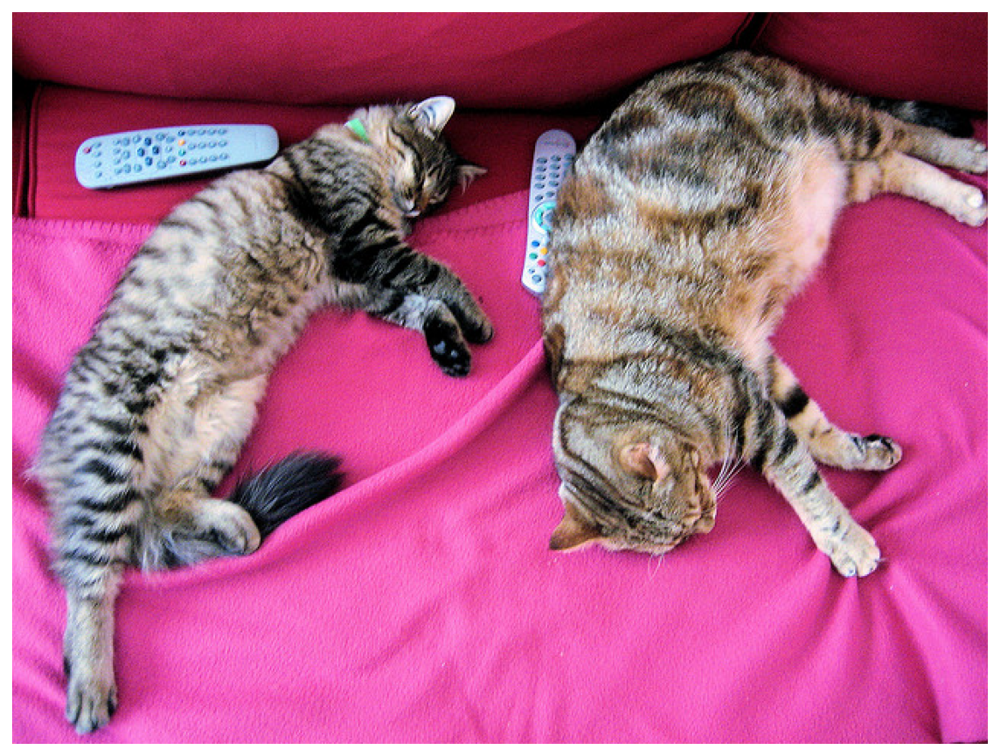

In [216]:
im = load_original('http://images.cocodataset.org/val2017/000000039769.jpg', True)

Run the image through the model and then display result:

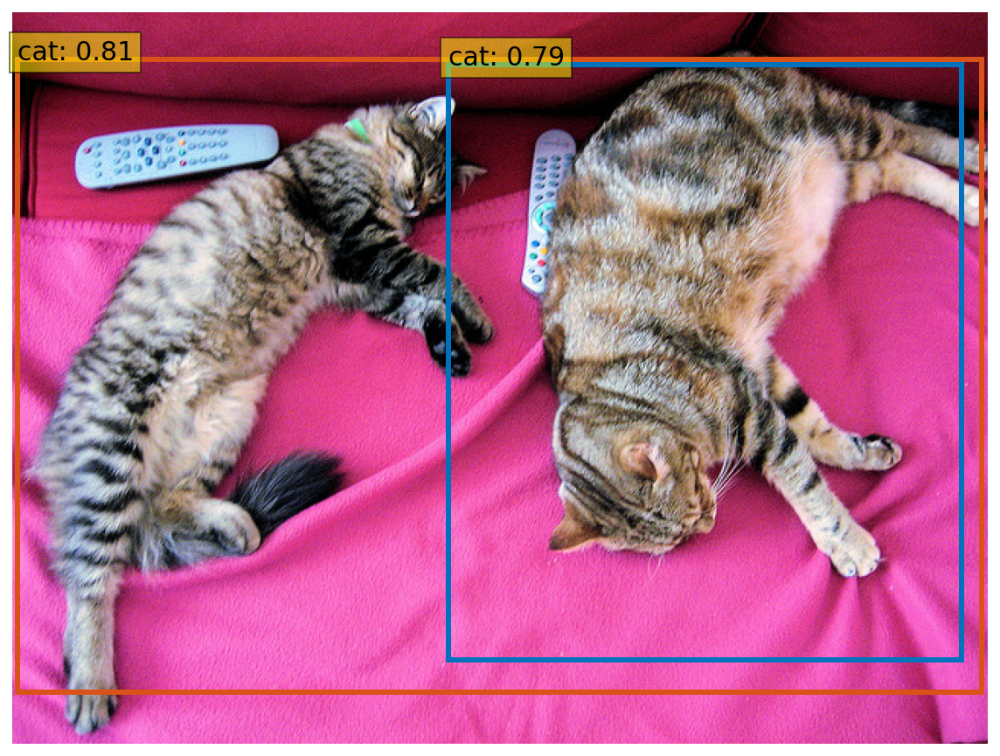

In [217]:
show_prediction(im)

#### Inference on COCO dataset images

im:  (480, 640)


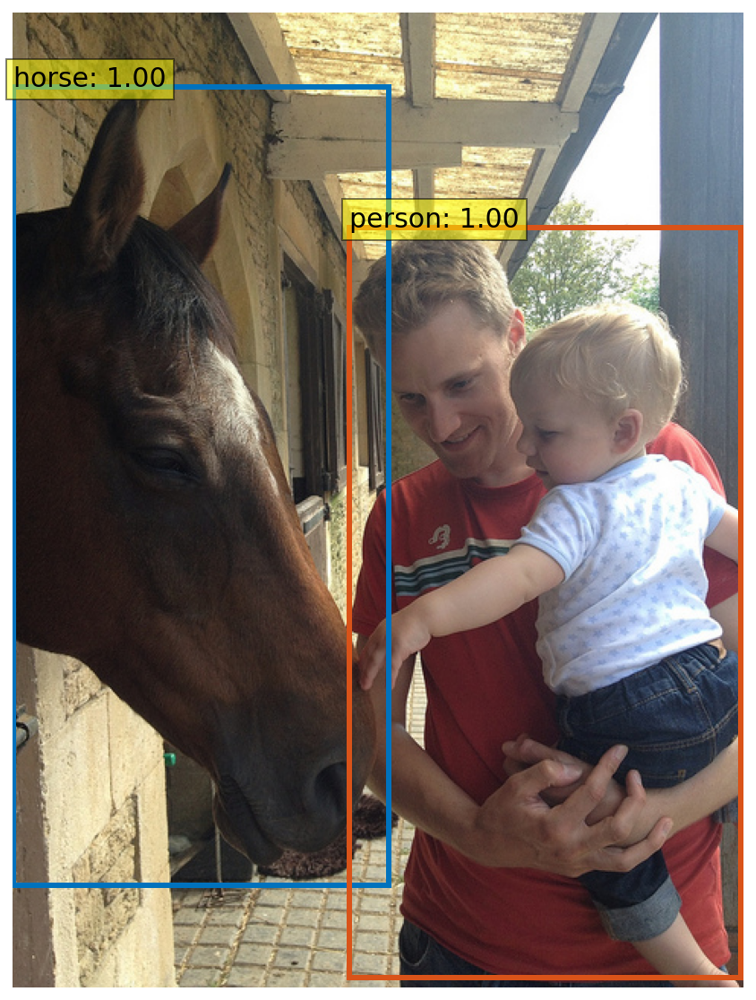

In [178]:
im = load_original('http://images.cocodataset.org/val2017/000000012748.jpg')
show_prediction(im)

im:  (640, 426)


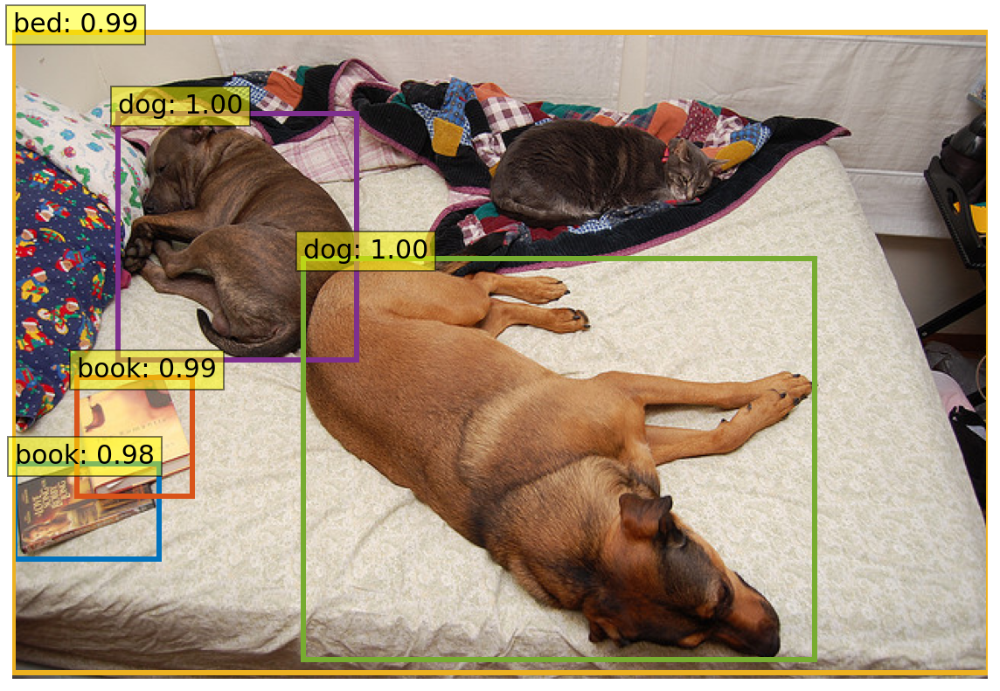

In [179]:
im = load_original('http://images.cocodataset.org/val2017/000000071226.jpg')
show_prediction(im)

im:  (640, 480)


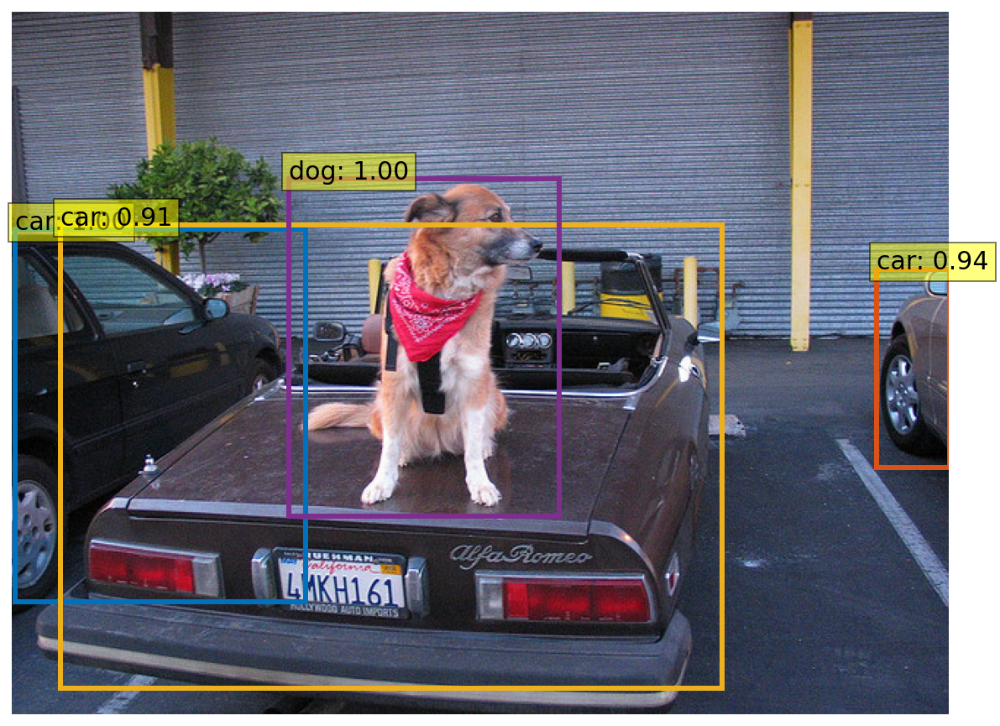

In [205]:
im = load_original('http://images.cocodataset.org/val2017/000000078823.jpg')
show_prediction(im)

#### Inference on Pascal VOC test dataset images

im:  (500, 249)


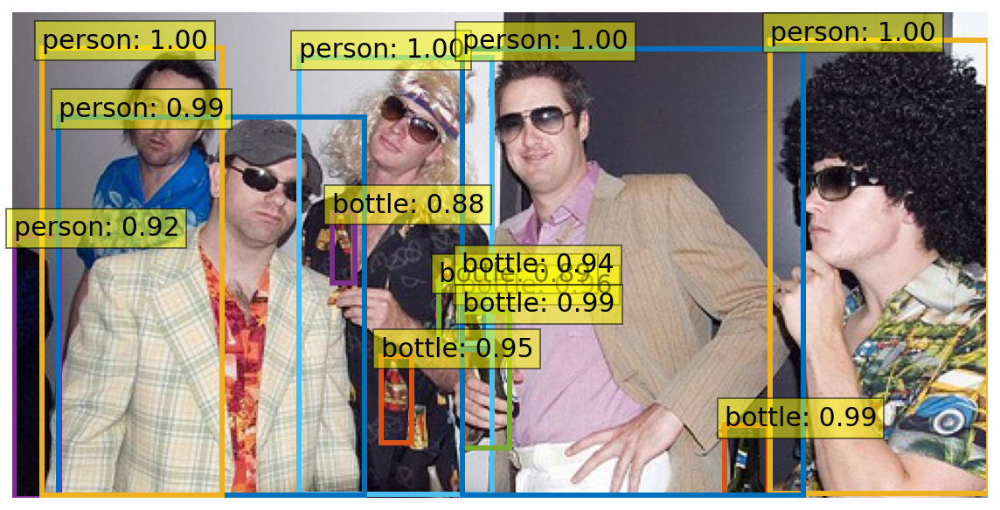

In [138]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000200.jpg")
show_prediction(im, 0.8)

im:  (500, 459)


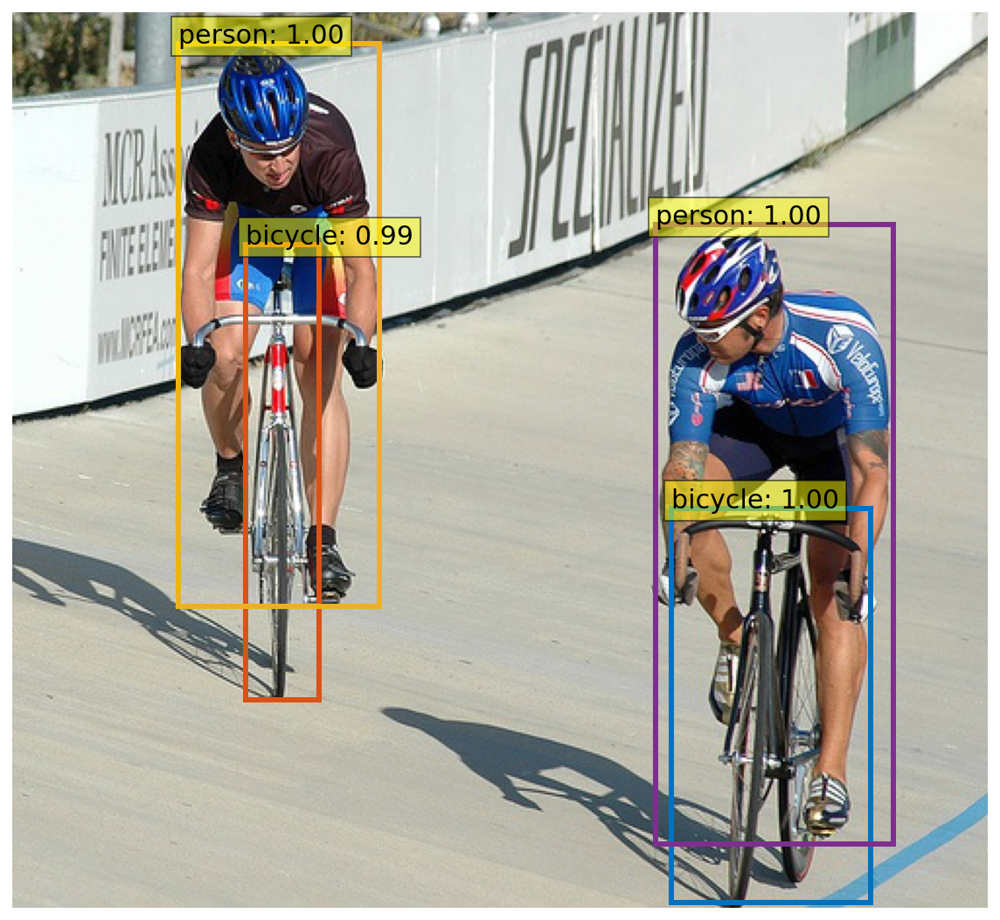

In [139]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000283.jpg")
show_prediction(im, 0.8)

im:  (500, 337)


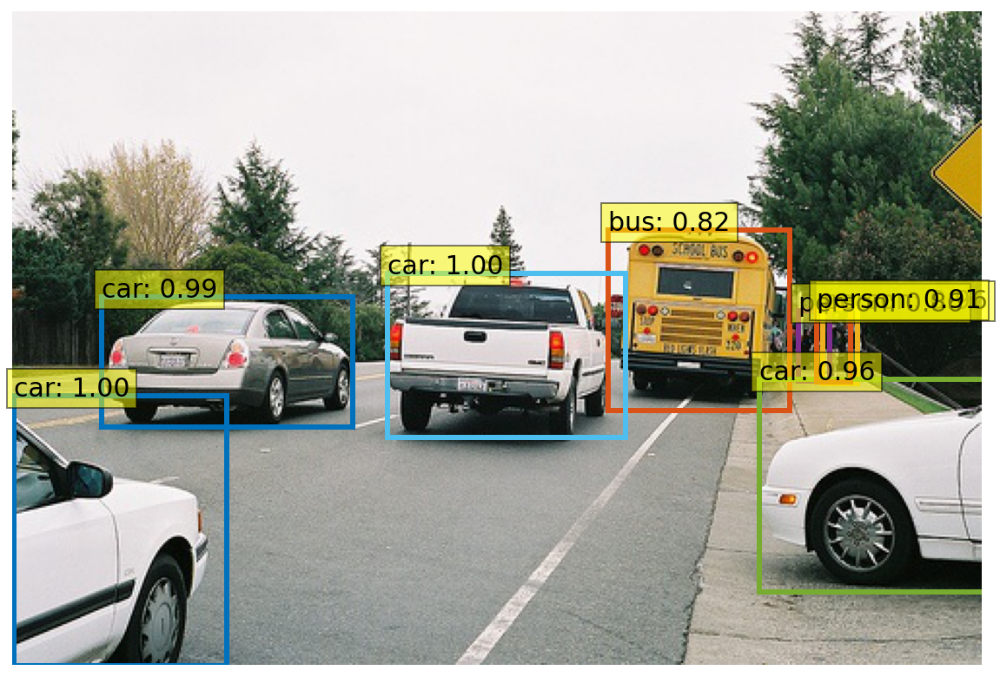

In [39]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000341.jpg")
show_prediction(im, 0.8)

im:  (375, 500)


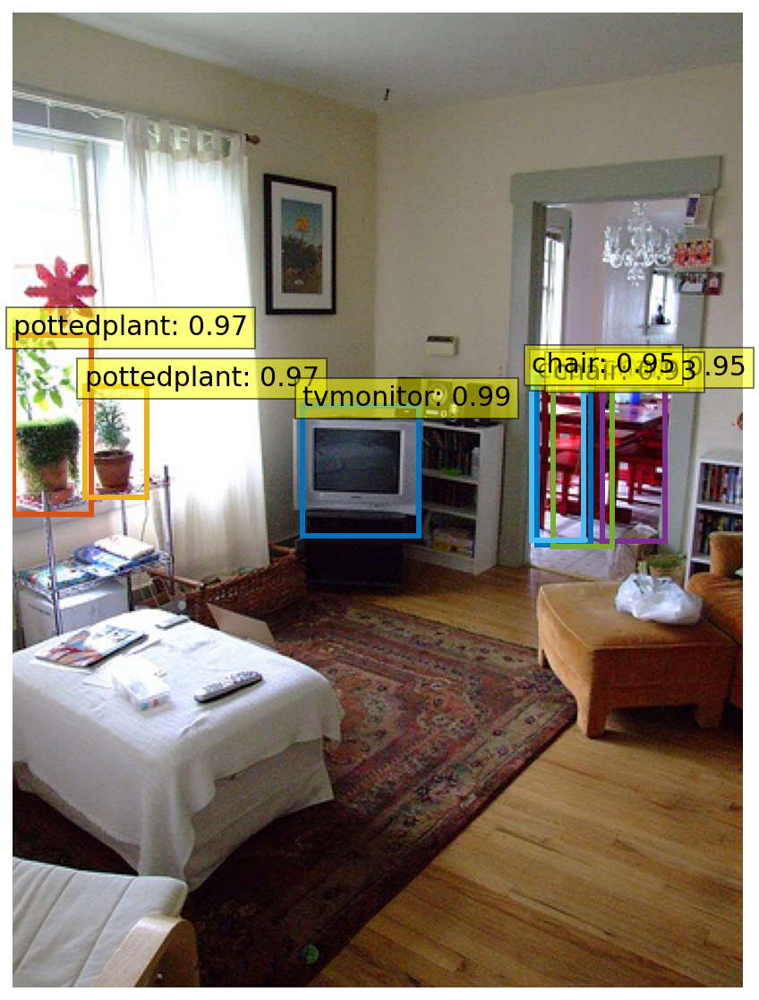

In [40]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000397.jpg")
show_prediction(im, 0.8)

im:  (500, 302)


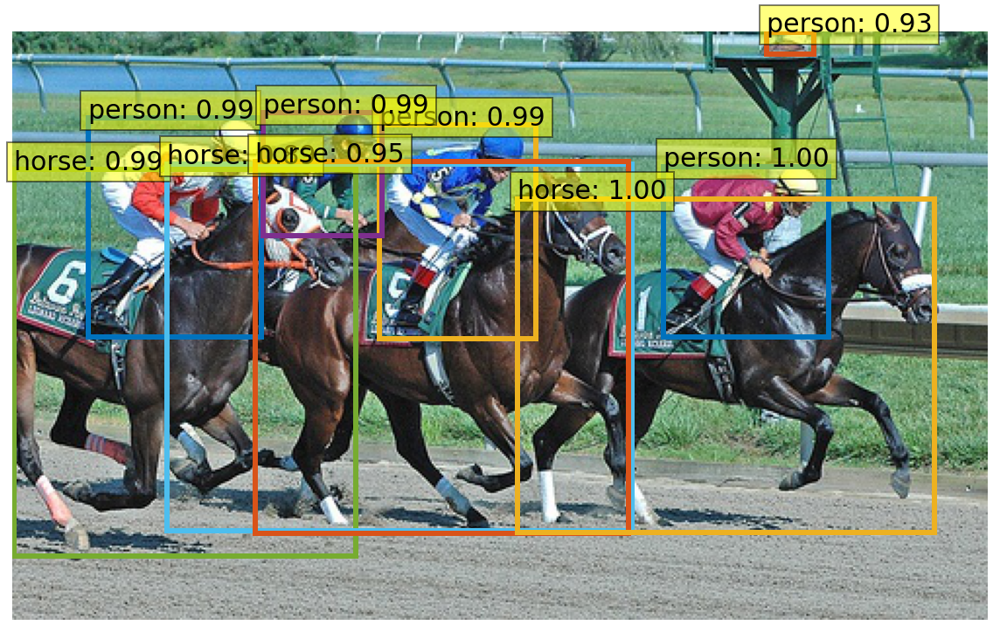

In [140]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000445.jpg")
show_prediction(im, 0.85)

im:  (500, 375)


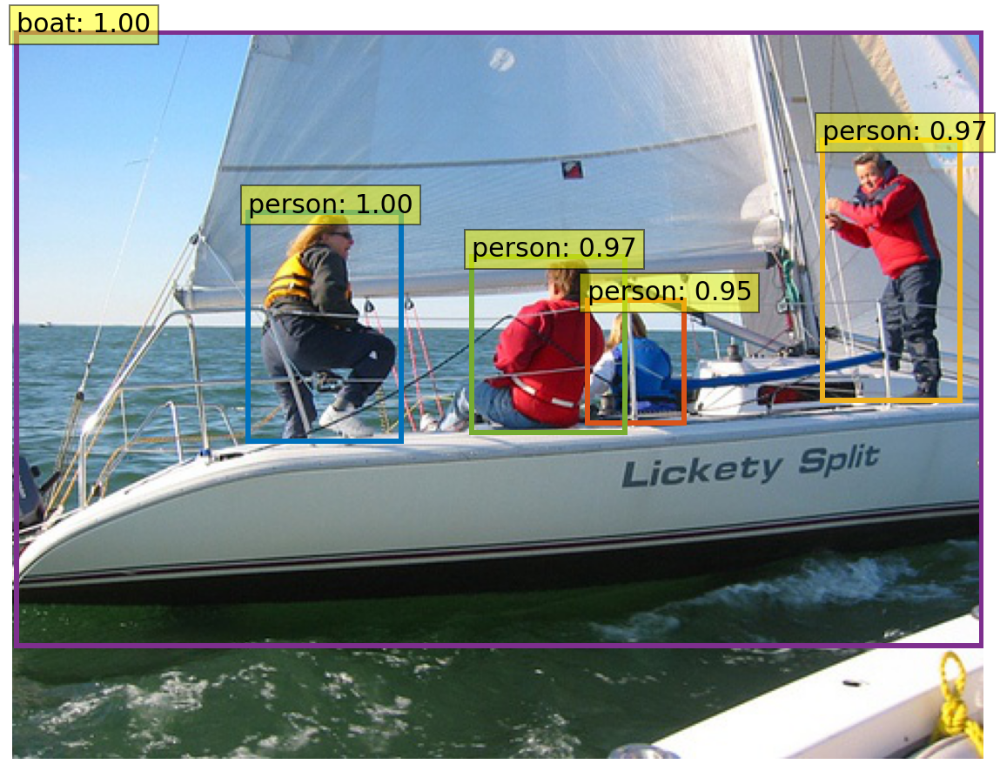

In [42]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\000449.jpg")
show_prediction(im, 0.8)

im:  (500, 333)


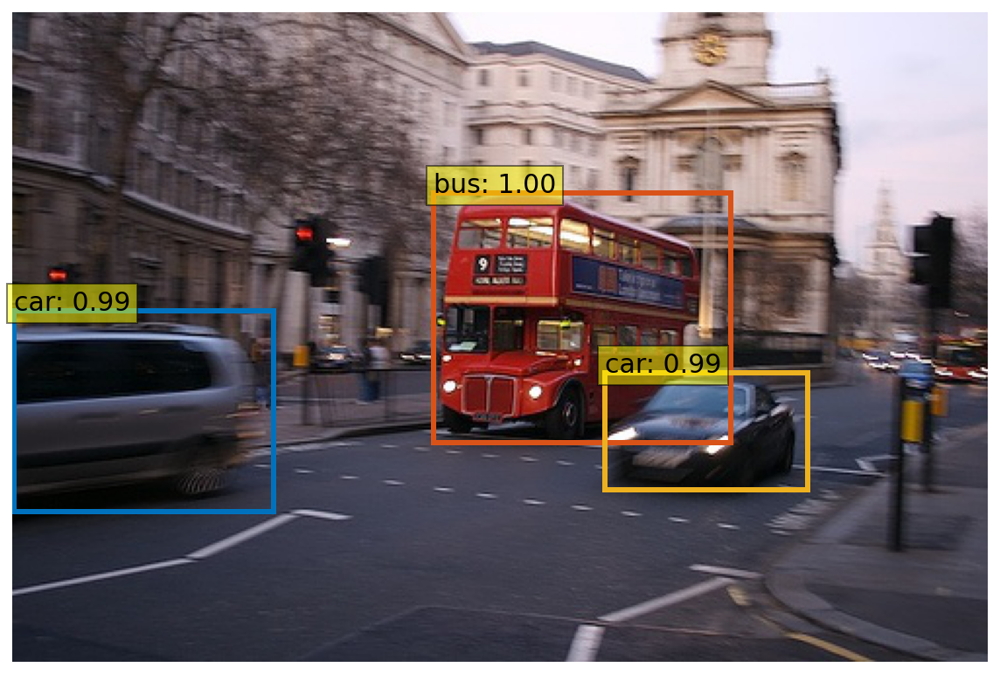

In [43]:
im = load_original("C:\\an4\\licenta\\datasets\\PascalVOC\\VOCdevkit\\VOC07_12\\val2017\\008488.jpg")
show_prediction(im, 0.8)

## Inference on image of choice from folder

In [180]:
_ = interact(show_images, fdir=directory, file=images)

interactive(children=(Dropdown(description='fdir', options=(('PascalVOC', 'C:\\an4\\licenta\\datasets\\PascalV…

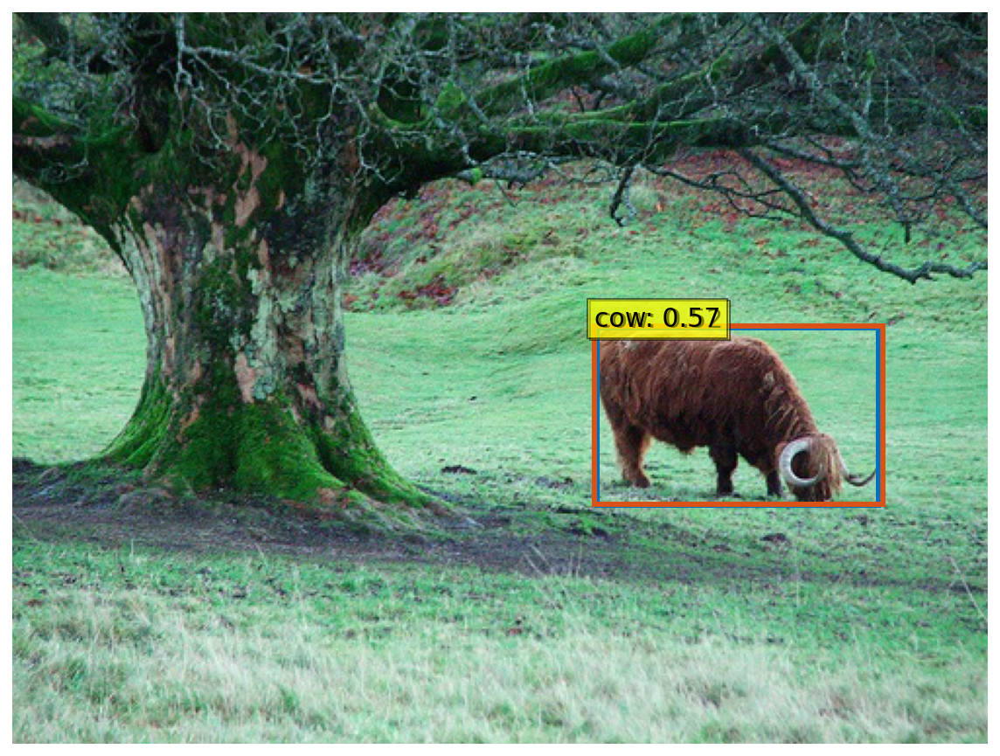

In [181]:
im = Image.open(directory.value+'\\'+images.value)
show_prediction(im, 0.5)

## Inference on image of choice from url

im:  (1500, 1121)


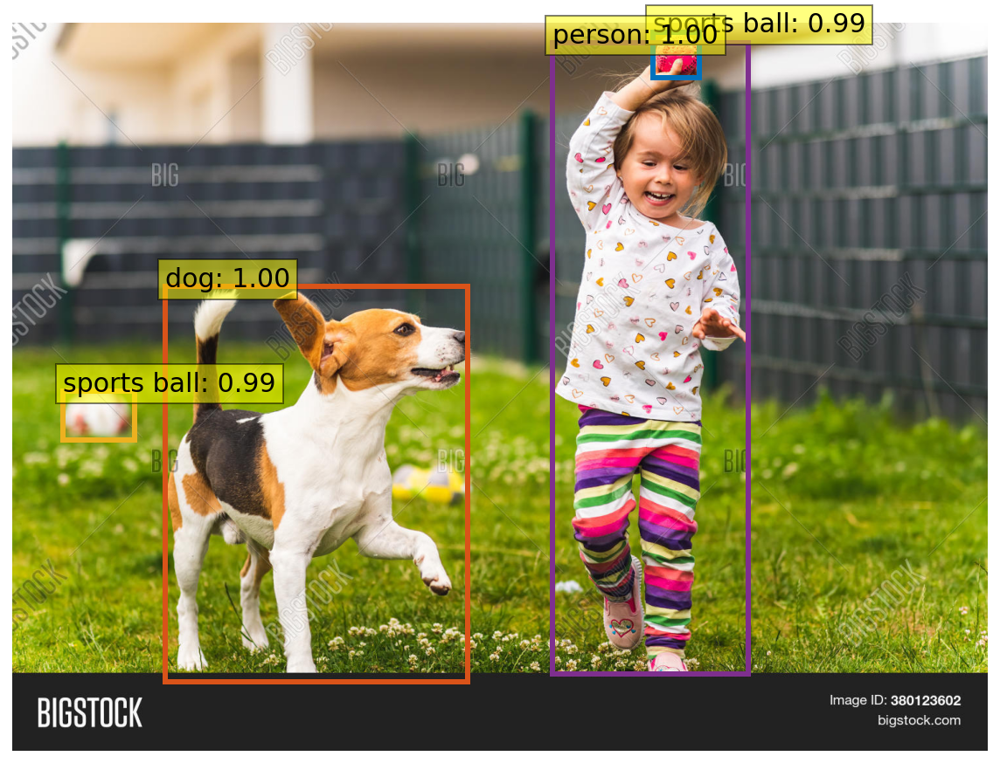

In [182]:
im = load_original('https://static3.bigstockphoto.com/0/8/3/large1500/380123602.jpg')
show_prediction(im)

# DETR based models

## Visualize encoder-decoder multi-head attention weights

-   visualise attention weights of the last decoder layer
-   i.e. visualise, for each detected object, where the model is looking to predict the class and bounding box

im:  (640, 480)


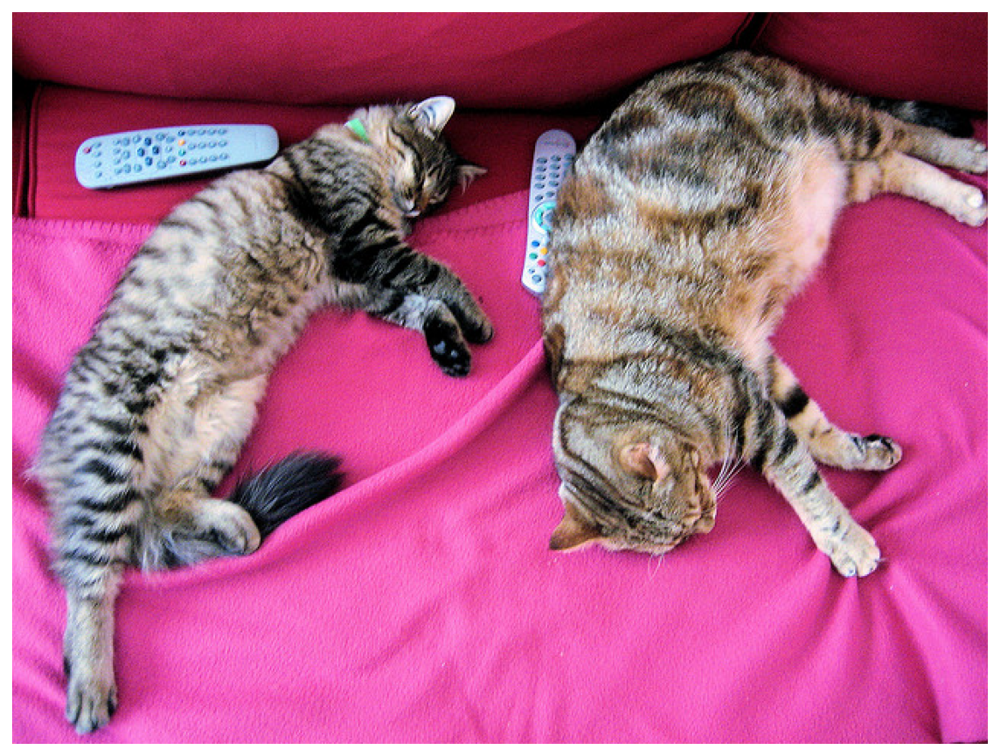

In [183]:
im = load_original('http://images.cocodataset.org/val2017/000000039769.jpg', True)

# mean-std normalize the input image (batch-size: 1)
img = transform(im).unsqueeze(0)

# propagate through the model
outputs = model(img)

# keep only predictions with 0.7+ confidence
probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
keep = probas.max(-1).values > 0.7

# convert boxes from [0; 1] to image scales
bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

In [184]:
# use lists to store the outputs via up-values
conv_features, enc_attn_weights, dec_attn_weights = [], [], []

# use hooks to extract attention weights
hooks = [
    model.backbone[-2].register_forward_hook(
        lambda self, input, output: conv_features.append(output)
    ),
    model.transformer.encoder.layers[-1].self_attn.register_forward_hook(
        lambda self, input, output: enc_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].multihead_attn.register_forward_hook(
        lambda self, input, output: dec_attn_weights.append(output[1])
    ),
]

# propagate through the model
outputs = model(img)

for hook in hooks:
    hook.remove()
    
# don't need the list anymore
conv_features = conv_features[0]
enc_attn_weights = enc_attn_weights[0]
dec_attn_weights = dec_attn_weights[0]

25 34
torch.Size([8, 100, 850])


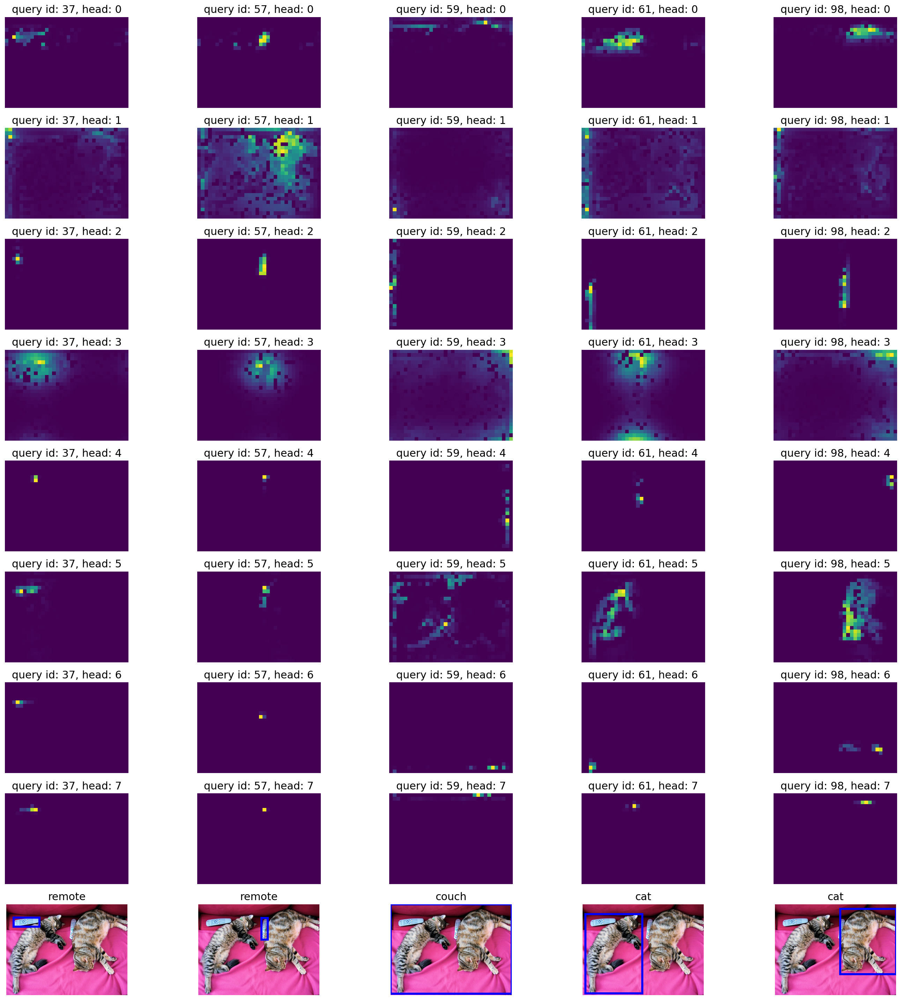

In [185]:
# get the feature map shape
if args.backbone == 'resnet50':
    h, w = conv_features['0'].tensors.shape[-2:]
elif args.backbone == 'mobilenet_v2':
    h, w = conv_features['18'].tensors.shape[-2:]
    
print(h, w)
print(dec_attn_weights.shape)

if model_type == 'coco':
    fig_w = 20
else:
    fig_w = 10

fig, axs = plt.subplots(ncols=len(bboxes_scaled), nrows=9, figsize=(fig_w, 20))
colors = COLORS * 100
for idx, ax_i, (xmin, ymin, xmax, ymax) in zip(keep.nonzero(), axs.T, bboxes_scaled):
    for i in range(8):
        ax = ax_i[i]
        ax.imshow(dec_attn_weights[i, idx].view(h, w))
        ax.axis('off')
        ax.set_title(f'query id: {idx.item()}, head: {i}', fontsize=15)
    
    ax = ax_i[8]
    ax.imshow(im)
    ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                               fill=False, color='blue', linewidth=3))
    ax.axis('off')
    ax.set_title(CLASSES[probas[idx].argmax()], fontsize=15)
fig.tight_layout()

## Visualize encoder self-attention weights

In [186]:
# output of the CNN
if args.backbone == 'resnet50':
    f_map = conv_features['0']
elif args.backbone == 'mobilenet_v2':
    f_map = conv_features['18']
print("Encoder attention:      ", enc_attn_weights.shape)
print("Feature map:            ", f_map.tensors.shape)

# get the HxW shape of the feature maps of the CNN
shape = f_map.tensors.shape[-2:]
# and reshape the self-attention to a more interpretable shape
sattn = enc_attn_weights[0].reshape(shape + shape)
print("Reshaped self-attention:", sattn.shape)

Encoder attention:       torch.Size([8, 850, 850])
Feature map:             torch.Size([1, 2048, 25, 34])
Reshaped self-attention: torch.Size([25, 34, 25, 34])


In [187]:
def enc_attn_vis(sattn):

    # downsampling factor for the CNN, is 32 for DETR and 16 for DETR DC5
    fact = 32

    # let's select 4 reference points for visualization
    idxs = [(158, 180), (400, 200), (200, 350), (440, 700),]

    # here we create the canvas
    fig = plt.figure(constrained_layout=True, figsize=(25 * 0.7, 8.5 * 0.7))
    # and we add one plot per reference point
    gs = fig.add_gridspec(2, 4)
    axs = [
        fig.add_subplot(gs[0, 0]),
        fig.add_subplot(gs[1, 0]),
        fig.add_subplot(gs[0, -1]),
        fig.add_subplot(gs[1, -1]),
    ]

    # for each one of the reference points, let's plot the self-attention
    # for that point
    for idx_o, ax in zip(idxs, axs):
        idx = (idx_o[0] // fact, idx_o[1] // fact)
        ax.imshow(sattn[..., idx[0], idx[1]], cmap='cividis', interpolation='nearest')
        ax.add_patch(plt.Circle((idx[1], idx[0]), 0.5, color='r'))
        ax.axis('off')
        ax.set_title(f'self-attention{idx_o}')

    # and now let's add the central image, with the reference points as red circles
    fcenter_ax = fig.add_subplot(gs[:, 1:-1])
    fcenter_ax.imshow(im)
    for (y, x) in idxs:
        scale = im.height / img.shape[-2]
        x = ((x // fact) + 0.5) * fact
        y = ((y // fact) + 0.5) * fact
        fcenter_ax.add_patch(plt.Circle((x * scale, y * scale), fact // 2, color='r'))
        fcenter_ax.axis('off')

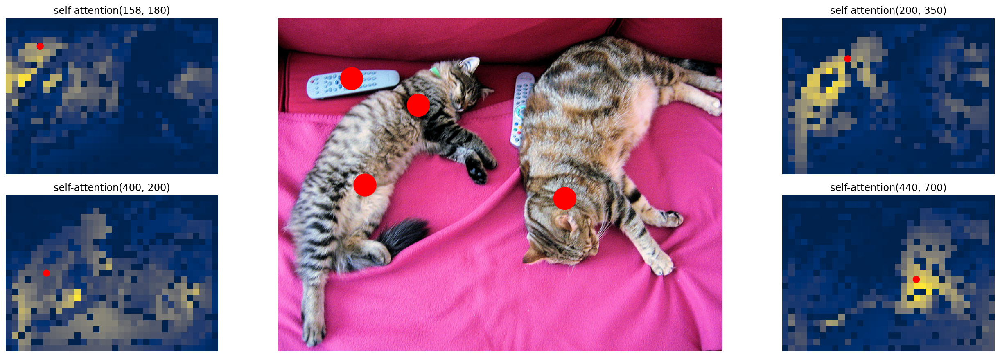

In [188]:
# y, x
enc_attn_vis(enc_attn_weights[0].reshape(shape + shape))

In [189]:
h, w = im.size
px = widgets.IntSlider(
    value=7,
    min=0,
    max=h,
    step=1,
    description='Point x coord:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d',
    layout=widgets.Layout(width='50%')
)
py = widgets.IntSlider(
    value=7,
    min=0,
    max=w,
    step=1,
    description='Point y coord:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d',
    layout=widgets.Layout(width='50%')
)

# Show the images
def show_point(*args):
    clear_output(wait=True)
    out = widgets.HBox([px, py])
    display(out)
#     im = load_original('http://images.cocodataset.org/val2017/000000071226.jpg')
    fig,ax = plt.subplots(1, figsize=(10,7))
    ax.axis('off')
    ax.imshow(im)
    circ = plt.Circle((px.value, py.value), 10, color='r')
    ax.add_patch(circ)
    plt.show()
    
px.observe(show_point, 'value')
py.observe(show_point, 'value')

In [190]:
def visualize(head='6'):
    sattn = enc_attn_weights[head].reshape(shape + shape)
    fig,ax = plt.subplots(1, figsize=(5,7))
    ax.axis('off')

    x = int(px.value*sattn.shape[-1]/im.size[0])
    y = int(py.value*sattn.shape[-2]/im.size[1])

    ax.imshow(sattn[..., y, x], cmap='cividis', interpolation='nearest')
    circ = plt.Circle((x, y), 1, color='r')
    ax.add_patch(circ)
    plt.show()

In [191]:
# x = 640/1066*700 = 420; y = 480/800*440 = 264
_ = interact(show_point)

interactive(children=(Output(),), _dom_classes=('widget-interact',))

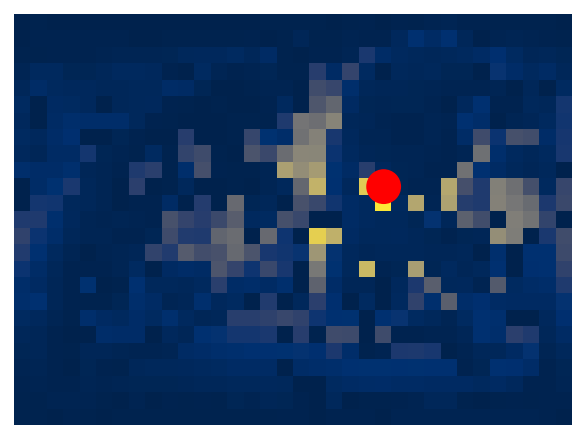

In [192]:
visualize(0)

# ViT based models

## Visualize encoder-decoder multi-head attention weights

-   visualise attention weights of the last decoder layer
-   i.e. visualise, for each detected object, where the model is looking to predict the class and bounding box

im:  (640, 480)
torch.Size([1, 3, 384, 384])


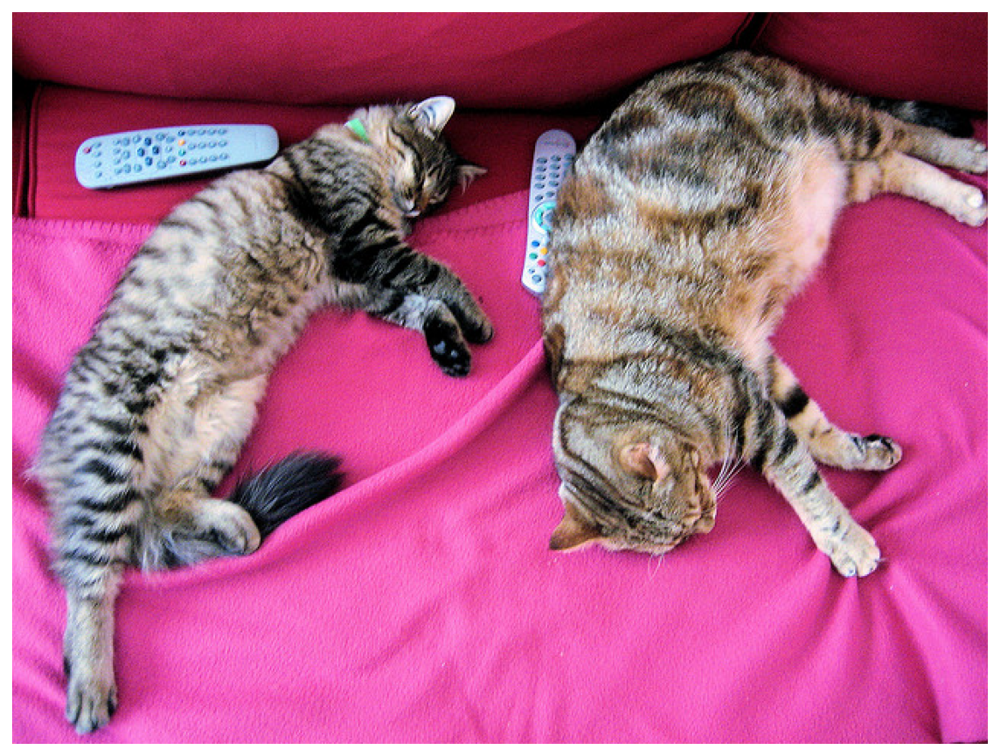

In [113]:
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = Image.open(requests.get(url, stream=True).raw)
print("im: ", im.size)

plot_image(im)

# mean-std normalize the input image (batch-size: 1)
img = transform(im).unsqueeze(0)
print(img.shape)

# propagate through the model
outputs = model(img)

# keep only predictions with 0.7+ confidence
probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
keep = probas.max(-1).values > 0.9

# convert boxes from [0; 1] to image scales
bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

In [114]:
# use lists to store the outputs via up-values
enc_attn_weights, dec_attn_weights = [], []

# use hooks to extract attention weights
hooks = [
    model.backbone.blocks[-1].attn.register_forward_hook(
        lambda self, input, output: enc_attn_weights.append(output[1])
    ),
    model.transformer.decoder.layers[-1].multihead_attn.register_forward_hook(
        lambda self, input, output: dec_attn_weights.append(output[1])
    ),
]

# propagate through the model
outputs = model(img)

for hook in hooks:
    hook.remove()
    
# don't need the list anymore
enc_attn_weights = enc_attn_weights[0]
dec_attn_weights = dec_attn_weights[0]

torch.Size([8, 100, 576])


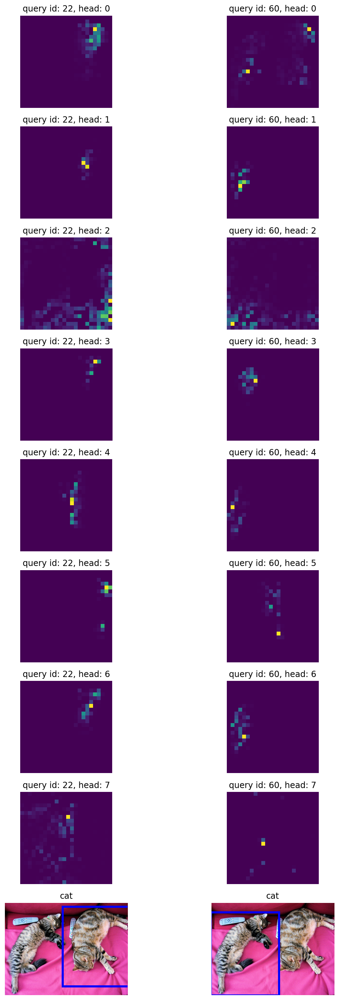

In [115]:
# get the feature map shape
h, w = 24, 24

print(dec_attn_weights.shape)

fig, axs = plt.subplots(ncols=len(bboxes_scaled), nrows=9, figsize=(10, 20))
colors = COLORS * 100
for idx, ax_i, (xmin, ymin, xmax, ymax) in zip(keep.nonzero(), axs.T, bboxes_scaled):
    for i in range(8):
        ax = ax_i[i]
        ax.imshow(dec_attn_weights[i, idx].view(h, w))
        ax.axis('off')
        ax.set_title(f'query id: {idx.item()}, head: {i}')
    
    ax = ax_i[8]
    ax.imshow(im)
    ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                               fill=False, color='blue', linewidth=3))
    ax.axis('off')
    ax.set_title(CLASSES[probas[idx].argmax()])
fig.tight_layout()

## Visualize encoder self-attention weights

In [116]:
print("Encoder attention:      ", enc_attn_weights[0, :, 1:, 1:].shape)
enc = enc_attn_weights[0, :, 1:, 1:]
N, C, _ = enc.shape
H, W = int(math.sqrt(C)), int(math.sqrt(C)) 
attn = enc.view(N, H, W, H, W)
print("attn:", attn.shape)
sattn = attn[-1]
print("Reshaped self-attention:", sattn.shape)

Encoder attention:       torch.Size([12, 576, 576])
attn: torch.Size([12, 24, 24, 24, 24])
Reshaped self-attention: torch.Size([24, 24, 24, 24])


In [117]:
print(im.size)
print(img.shape)
print(sattn.shape)

(640, 480)
torch.Size([1, 3, 384, 384])
torch.Size([24, 24, 24, 24])


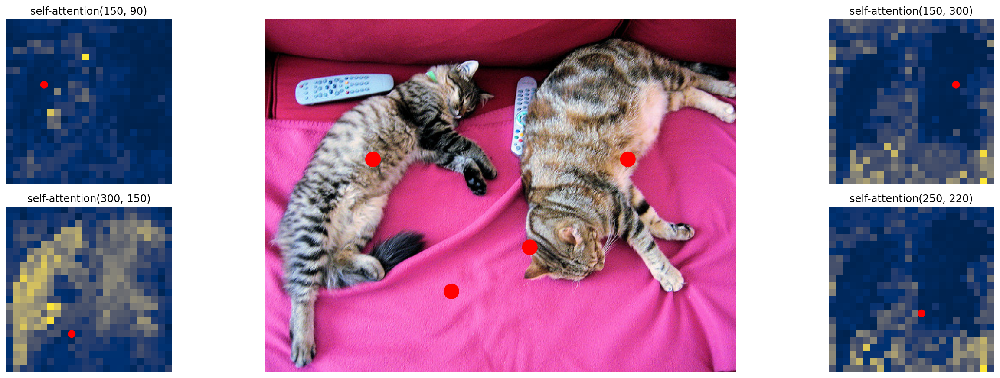

In [118]:
# downsampling factor for the CNN, is 32 for DETR and 16 for DETR DC5
fact = 16

# let's select 4 reference points for visualization
idxs = [(150, 90), (300, 150), (150, 300), (250, 220)]

# here we create the canvas
fig = plt.figure(constrained_layout=True, figsize=(25 * 0.7, 8.5 * 0.7))
# and we add one plot per reference point
gs = fig.add_gridspec(2, 4)
axs = [
    fig.add_subplot(gs[0, 0]),
    fig.add_subplot(gs[1, 0]),
    fig.add_subplot(gs[0, -1]),
    fig.add_subplot(gs[1, -1]),
]

# for each one of the reference points, let's plot the self-attention
# for that point
for idx_o, ax in zip(idxs, axs):
    idx = (idx_o[0] // fact, idx_o[1] // fact)
    ax.imshow(sattn[..., idx[0], idx[1]], cmap='cividis', interpolation='nearest')
    ax.add_patch(plt.Circle((idx[1], idx[0]), 0.5, color='r'))
    ax.axis('off')
    ax.set_title(f'self-attention{idx_o}')

# and now let's add the central image, with the reference points as red circles
fcenter_ax = fig.add_subplot(gs[:, 1:-1])
fcenter_ax.imshow(im)
for (y, x) in idxs:
    scale_y = im.height / img.shape[-2]
    scale_x = im.width / img.shape[-1]
    x = ((x // fact) + 0.5) * fact
    y = ((y // fact) + 0.5) * fact
    fcenter_ax.add_patch(plt.Circle((x * scale_x, y * scale_y), 10, color='r'))
    fcenter_ax.axis('off')

In [119]:
h, w = im.size
px = widgets.IntSlider(
    value=7,
    min=0,
    max=h,
    step=1,
    description='Point x coord:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d',
    layout=widgets.Layout(width='50%')
)
py = widgets.IntSlider(
    value=7,
    min=0,
    max=w,
    step=1,
    description='Point y coord:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d',
    layout=widgets.Layout(width='50%')
)

# Show the images
def show_point(*args):
    clear_output(wait=True)
    out = widgets.HBox([px, py])
    display(out)
#     im = load_original('http://images.cocodataset.org/val2017/000000071226.jpg')
    fig,ax = plt.subplots(1, figsize=(10,7))
    ax.axis('off')
    ax.imshow(im)
    circ = plt.Circle((px.value, py.value), 10, color='r')
    ax.add_patch(circ)
    plt.show()
    
px.observe(show_point, 'value')
py.observe(show_point, 'value')

In [120]:
def visualize():
    fig,ax = plt.subplots(1, figsize=(5,7))
    ax.axis('off')

    x = int(px.value*sattn.shape[-1]/im.size[0])
    y = int(py.value*sattn.shape[-2]/im.size[1])

    ax.imshow(sattn[..., y, x], cmap='cividis', interpolation='nearest')
    circ = plt.Circle((x, y), 0.5, color='r')
    ax.add_patch(circ)
    plt.show()

In [121]:
# x = 640/1066*700; y = 480/800*440 
_ = interact(show_point)

interactive(children=(Output(),), _dom_classes=('widget-interact',))

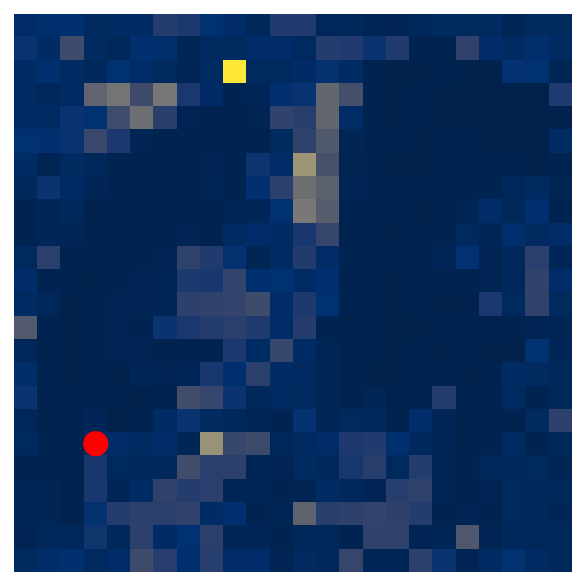

In [122]:
visualize()